# tree triangulation and mapping

The goal of this notebook is to map trees

Steps

function get_clossest_refpoints_for_tree:
- get felling cut of tree
- get $k$ closest 2D refpoints that have a 3D refpoint ( keypoint3d = -1 )




workflow pseudo code:
foreach json:
    foreach detected tree in json:
        if score < 85%:
            continue
        if overlap with other tree prediction boxes: (already kinda done)
            continue            
        match treepoint [felling cut] from 2D image to 3D refpoint:
            you have a list of 2D refpoints
            use only the 2D refpoints that are linked with a 3D refpoints
                this can be done with a simple 
                    if keypoint3d != -1
            take the refpoint that is closest to the treepoint [felling cut OF middle point] in 2D and has a linked 3D refpoint (this is just the keypoint3d ID)

            Draw sphere of 1.5 meters around the 3d point
            IF the linked 3D refpoint falls within the sphere => we have a duplicate detection of the same tree
            We will still add this to our tree list (this gives us the option to get an average tree diamater and coords later)
                Add linked 3D refpoint to all_detections
                Also add score to all_detections
                Get diameter from depth map and add to all_detections
                    depth map has same image name as original 2d image but needs to be resized
                    then find 2d points in depthmap and calculate size in units
                    divide by units per meter => this parameter is shown above
                    store diameter in units
                    store diameter in meters
            Use the score to determine which detection from all_detections is best and put this in 
            - best_3d_coords (x,y,z)
            - best_score
            - best_diameter in units
            - best_diameter in meters
            Update 
            - average_3d_coords (with some middlepoint of the cluster)
            - average_diameter in units
            - average_diameter in meters


In [1]:
# imports
import json



In [2]:
from glob import glob

output_dir = './assets/annotated_05/eastbound'
json_dir_pattern = output_dir + '/*.json'

json_paths = glob(json_dir_pattern)
json_paths.sort()

print(json_paths)

['./assets/annotated_05/eastbound\\eastbound_20240319_07816.json', './assets/annotated_05/eastbound\\eastbound_20240319_07821.json', './assets/annotated_05/eastbound\\eastbound_20240319_07826.json', './assets/annotated_05/eastbound\\eastbound_20240319_07831.json', './assets/annotated_05/eastbound\\eastbound_20240319_07836.json', './assets/annotated_05/eastbound\\eastbound_20240319_07841.json', './assets/annotated_05/eastbound\\eastbound_20240319_07846.json', './assets/annotated_05/eastbound\\eastbound_20240319_07851.json', './assets/annotated_05/eastbound\\eastbound_20240319_07856.json', './assets/annotated_05/eastbound\\eastbound_20240319_07861.json', './assets/annotated_05/eastbound\\eastbound_20240319_07866.json', './assets/annotated_05/eastbound\\eastbound_20240319_07871.json', './assets/annotated_05/eastbound\\eastbound_20240319_07876.json', './assets/annotated_05/eastbound\\eastbound_20240319_07881.json', './assets/annotated_05/eastbound\\eastbound_20240319_07886.json', './assets

In [3]:
# WORKFLOW


import json

for i in range(len(json_paths)):
    # quick and dirty way to read only a few files
    if i < 99:
        continue
    elif i > 102:
        break

    print("Currently reading file:")
    js = json_paths[i]
    print(js)
    print()
    with open(js, 'r') as js:
        data = json.load(js)
    
        # Display the contents of the JSON file
        # print(data)
        print('Prediction Boxes')        
        num_of_recognized_trees = len(data['pred_boxes'])
        print("Number of detected trees: ", num_of_recognized_trees)
        for j in range(num_of_recognized_trees):
            print(data['pred_boxes'][j])
        
        
        for j in range(num_of_recognized_trees):
            print()
            tree_num = j
            print(f'Tree number: {tree_num} || Confidence score: {data["scores"][j]}')
            print()    
            print('Prediction Keypoints - (x, y, ??)')
            keypoint_names =  ['felling cut (middelste punt onderaan)', 
                               'diameter LEFT (most left point of tree)', 
                               'diameter RIGHT (most right point of tree)', 
                               'tree middle (in camera view)', 
                               'tree top (in camera view)']
            for k in range(5):        
                print('*', keypoint_names[k])
                print(data['pred_keypoints'][j][k])
            print()
            print('X left < X right (always)')
            print('Pixel distance: X right - X left')
            print(data['pred_keypoints'][j][2][0] - data['pred_keypoints'][j][1][0])
            print()
            # break
        # break # only read the first file for testing purposes

Currently reading file:
./assets/annotated_05/eastbound\eastbound_20240319_08311.json

Prediction Boxes
Number of detected trees:  2
[390.8311767578125, 1.288764238357544, 519.2897338867188, 867.3510131835938]
[955.5457153320312, 37.45699691772461, 1019.9951171875, 756.1049194335938]

Tree number: 0 || Confidence score: 0.9998266100883484

Prediction Keypoints - (x, y, ??)
* felling cut (middelste punt onderaan)
[448.0353698730469, 817.6588745117188, 1.363664150238037]
* diameter LEFT (most left point of tree)
[399.8634338378906, 795.34814453125, 0.7279067635536194]
* diameter RIGHT (most right point of tree)
[500.2216491699219, 801.4329223632812, 1.0405701398849487]
* tree middle (in camera view)
[462.0855407714844, 436.3481140136719, 0.7011321783065796]
* tree top (in camera view)
[484.1643371582031, 4.331137180328369, 0.6286429166793823]

X left < X right (always)
Pixel distance: X right - X left
100.35821533203125


Tree number: 1 || Confidence score: 0.87246173620224

Prediction K

In [7]:
import numpy as np

def load_images(file_path):
    images = {}
    with open(file_path, 'r') as f:
        while True:
            line = f.readline()
            if not line:
                break
            if line.startswith('#'):
                continue
            elements = line.split()
            image_id = int(elements[0])
            qw, qx, qy, qz = map(float, elements[1:5])
            tx, ty, tz = map(float, elements[5:8])
            camera_id = int(elements[8])
            image_name = elements[9]

            line = f.readline()
            points2d = []
            elements = line.split()
            for i in range(0, len(elements), 3):
                x, y, point3d_id = map(float, elements[i:i+3])
                points2d.append([x, y, int(point3d_id)])
            points2d = np.array(points2d)

            images[image_name] = {
                'image_id': image_id,
                'qw': qw, 'qx': qx, 'qy': qy, 'qz': qz,
                'tx': tx, 'ty': ty, 'tz': tz,
                'camera_id': camera_id, 'image_name': image_name, 'points2d': points2d
            }
    return images

def load_points3d(file_path):
    points3d = {}
    with open(file_path, 'r') as f:
        for line in f:
            if line.startswith('#'):
                continue
            elements = line.split()
            point_id = int(elements[0])
            xyz = np.array(elements[1:4], dtype=float)
            rgb = np.array(elements[4:7], dtype=int)
            error = float(elements[7])
            track = np.array(elements[8:], dtype=int).reshape(-1, 2)
            points3d[point_id] = {'xyz': xyz, 'rgb': rgb, 'error': error, 'track': track}
    return points3d

def find_corresponding_3d_points(image_data, keypoints_2d, points3d):
    corresponding_3d_points = []
    for kp in keypoints_2d:
        x, y = kp
        distances = np.linalg.norm(image_data['points2d'][:, :2] - np.array([x, y]), axis=1)
        closest_point_idx = np.argmin(distances)
        point2d_id = image_data['points2d'][closest_point_idx, 2]
        if point2d_id != -1:
            corresponding_3d_points.append(points3d[point2d_id]['xyz'])
        else:
            corresponding_3d_points.append(None)
    return corresponding_3d_points

def interpolate_missing_point(p1, p2):
    if p1 is None and p2 is not None:
        return p2
    if p1 is not None and p2 is None:
        return p1
    if p1 is not None and p2 is not None:
        return (np.array(p1) + np.array(p2)) / 2
    return None

def ensure_all_points_mapped(corresponding_3d_points):
    n = len(corresponding_3d_points)
    for i in range(n):
        if corresponding_3d_points[i] is None:
            left = None
            right = None
            if i > 0:
                left = corresponding_3d_points[i-1]
            if i < n-1:
                right = corresponding_3d_points[i+1]
            corresponding_3d_points[i] = interpolate_missing_point(left, right)
    return corresponding_3d_points

def calculate_distance_3d(p1, p2):
    return np.linalg.norm(np.array(p1) - np.array(p2))



images = load_images('./assets/sparse_text/images.txt')
points3d = load_points3d('./assets/sparse_text/points3D.txt')

In [8]:
images

{'eastbound/eastbound_20240319_07826.png': {'image_id': 1,
  'qw': 0.9885664846997114,
  'qx': -0.13166405620748858,
  'qy': -0.07050102177867344,
  'qz': -0.020748194128879315,
  'tx': -0.04210452406741276,
  'ty': -0.3102849047561297,
  'tz': 5.986669643013593,
  'camera_id': 1,
  'image_name': 'eastbound/eastbound_20240319_07826.png',
  'points2d': array([[ 3.74924591e+02,  7.99250122e+02, -1.00000000e+00],
         [ 4.58741058e+02,  3.06999451e+02, -1.00000000e+00],
         [ 2.44384399e+03,  5.12324097e+02, -1.00000000e+00],
         ...,
         [ 2.45068335e+03,  4.00462036e+02, -1.00000000e+00],
         [ 2.46934058e+03,  4.00534760e+02, -1.00000000e+00],
         [ 1.84377637e+03,  6.64885254e+02,  1.42500000e+03]])},
 'eastbound/eastbound_20240319_07846.png': {'image_id': 2,
  'qw': 0.9887205326475381,
  'qx': -0.13261891021262018,
  'qy': -0.06618873621539927,
  'qz': -0.02151706702582321,
  'tx': 0.00474802101350259,
  'ty': -0.2869067493496241,
  'tz': 5.68533521970799

[(352, 830), (2455, 842), (2024, 774), (990, 746), (2181, 816), (2178, 818)]


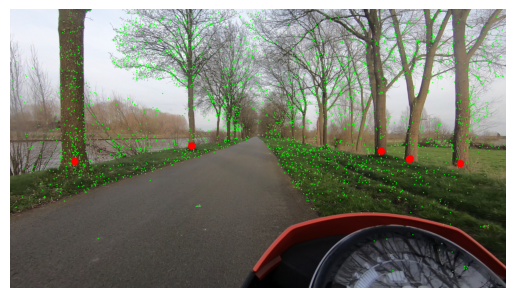

In [38]:
# visualize felling cut with 2d refpoints

import cv2
import matplotlib.pyplot as plt
import json



name = 'eastbound_20240319_07851'

image_path = f"{name}.png"
json_path = f"{name}.json"


with open(f"./assets/annotated_05/eastbound/{json_path}", 'r') as file:
    data = json.load(file)

# print(data)
# print(data['name'])



# Load the image
image = cv2.imread(f"./assets/undistorted_05/eastbound/{image_path}")

if image is None:
    print(f"Error loading image: {image_path}")
else:
    # Get the points2d for the specified image
    points2d = images['eastbound/eastbound_20240319_07851.png']['points2d']
    refpoints = []

    # Draw the points on the image
    for point in points2d:
        x, y, id = point

        

        if id != -1:
            refpoints.append((int(x), int(y), id))
            cv2.circle(image, (int(x), int(y)), radius=3, color=(0, 255, 0), thickness=-1)


    felling_points = []

    for tree_keypoints in data["pred_keypoints"]:
        felling_points.append((int(tree_keypoints[0][0]), int(tree_keypoints[0][1])))
        cv2.circle(image, (int(tree_keypoints[0][0]), int(tree_keypoints[0][1])), radius=20, color=(0,0,255), thickness=-1)

    # Display the image with the drawn points

    print(felling_points)

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [22]:
points2d

array([[ 2.25417041e+03,  4.79249176e+02, -1.00000000e+00],
       [ 8.32683044e+02,  4.60156006e+02,  1.65500000e+03],
       [ 1.44733606e+03,  6.19533203e+02, -1.00000000e+00],
       ...,
       [ 1.14137683e+03,  4.58088837e+02, -1.00000000e+00],
       [ 1.28507983e+03,  4.58327301e+02, -1.00000000e+00],
       [ 6.74107605e+02,  1.67073608e+02, -1.00000000e+00]])

In [41]:



## points2d
## felling_points

k=5

closest_points = k_closest_points(np.array(refpoints), np.array(felling_points[0]), k)

In [42]:
closest_points

array([[  346.,   823., 65069.],
       [  352.,   843., 65405.],
       [  357.,   818., 65068.],
       [  337.,   842., 66488.],
       [  350.,   850., 65411.]])

[(352, 830), (2455, 842), (2024, 774), (990, 746), (2181, 816), (2178, 818)]


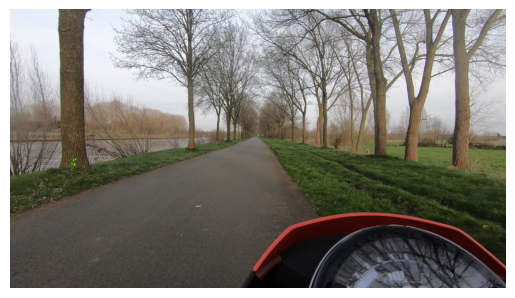

In [43]:
# visualize felling cut with 2d refpoints

import cv2
import matplotlib.pyplot as plt
import json





# print(data)
# print(data['name'])



# Load the image
image = cv2.imread(f"./assets/undistorted_05/eastbound/{image_path}")

if image is None:
    print(f"Error loading image: {image_path}")
else:
    # Get the points2d for the specified image
    points2d = images['eastbound/eastbound_20240319_07851.png']['points2d']

    # Draw the points on the image
    for point in closest_points:
        cv2.circle(image, (int(point[0]), int(point[1])), radius=5, color=(0, 255, 0), thickness=-1)


    felling_points = []

    for tree_keypoints in data["pred_keypoints"]:
        felling_points.append((int(tree_keypoints[0][0]), int(tree_keypoints[0][1])))
        cv2.circle(image, (int(tree_keypoints[0][0]), int(tree_keypoints[0][1])), radius=5, color=(0,0,255), thickness=-1)

    # Display the image with the drawn points

    print(felling_points)

    image_rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    plt.imshow(image_rgb)
    plt.axis('off')
    plt.show()

In [82]:

# get k closest points to a target point
def k_closest_points(points, target_point, k=3):
    temp = [(x, y) for x, y, _ in points]

    # print(temp)

    distances = np.linalg.norm(temp - target_point, axis=1)
    
    k_indices = np.argsort(distances)[:k]
    
    return points[k_indices]


def get_closest_3d_points_for_felling_cut(points2d, points3d, felling_cut):
    closest_points = k_closest_points(np.array(points2d), np.array(felling_cut))

    closest_points_3d = []

    for point in closest_points:
        punt3d_id = point[2]

        closest_points_3d.append(points3d[int(punt3d_id)])

    return closest_points_3d


def get_closest_3d_points_for_image(points2d, points3d, pred_keypoints):

    closest_points = []
    
    for treepoints in pred_keypoints:
        felling_cut = treepoints[0]
        # print(felling_cut)
        felling_point = (felling_cut[0], felling_cut[1])

        closest_points_3d = get_closest_3d_points_for_felling_cut(points2d, points3d, felling_point)

        closest_points.append(closest_points_3d)

    return closest_points





# points = []

# for tree_points in test:
#     temp = []
#     for point_3d in tree_points:
#         temp.append(point_3d['xyz'])

#     points.append(temp)

# points

In [122]:
import json

JSON_LOC = "./assets/annotated_05/eastbound/"
IMG_LOC  = "./assets/undistorted_05/eastbound/"

def get_json_data(json_path):
    with open(f"./assets/annotated_05/eastbound/{json_path}", 'r') as file:
        data = json.load(file)

    # with open(json_path, 'r') as file:
    #     data = json.load(file)

    return data


# filters out 2d points that have no corresponding 3d point
def get_filtered_points(points2d):
    filtered_points2d = []
    for point in points2d:
        if int(point[2]) > -1:
            filtered_points2d.append(point)

    return filtered_points2d


def getNumber(x):
    num_w_ext = x.split('_')[2]
    num = num_w_ext.split('.')[0]
    return num


import os

folder_path = './assets/undistorted_05/eastbound'
JSON_LOC = "./assets/annotated_05/eastbound/"
IMG_LOC  = "./assets/undistorted_05/eastbound/"

files = os.listdir(folder_path)
sorted_files = sorted(files, key=lambda x: int(getNumber(x)))


another_list = []

for i, image in enumerate(sorted_files):
    
    
    # quick and dirty way to read only a few files
    if i < 50:
        continue
    elif i > 150:
        break

    print(image)
    print(i)

    # get pred keypoints

    json_name = image.replace('.png', '.json')

    with open(JSON_LOC + json_name, 'r') as js:
        data = json.load(js)


    pred_keypoints = data["pred_keypoints"]

    # get points2d

    points2d = images[f"eastbound/{image}"]['points2d']
    filtered_points2d = get_filtered_points(points2d)

    # get closest points

    closest_3d_points = get_closest_3d_points_for_image(filtered_points2d, points3d, data["pred_keypoints"])


    another_list.append(closest_3d_points)
    print("lenght closest points", len(closest_3d_points))
    print("length another list", len(another_list))


eastbound_20240319_08066.png
50
[(1892.388671875, 451.0474548339844), (844.2788696289062, 762.7208251953125), (779.1217651367188, 464.165771484375), (1188.651123046875, 430.2313537597656), (406.7391357421875, 941.7308349609375), (2267.333740234375, 966.2774047851562), (1355.6591796875, 300.142578125), (1071.4498291015625, 616.46142578125), (2279.38134765625, 774.975830078125), (2139.90234375, 309.882568359375), (1239.085205078125, 556.420166015625), (1727.5242919921875, 669.8283081054688), (597.8187866210938, 905.029052734375), (415.1973571777344, 806.1112670898438), (682.3106689453125, 153.73419189453125), (2355.393310546875, 157.3631134033203), (2376.541015625, 328.42596435546875), (1776.509521484375, 539.302734375), (1988.1309814453125, 694.324951171875), (1628.3895263671875, 678.0950317382812), (1194.8895263671875, 716.3604125976562), (2487.93408203125, 743.1107788085938), (2344.36328125, 817.790771484375), (1580.3109130859375, 898.261962890625), (2312.631591796875, 82.859436035156

In [123]:
aaaaaa_points = []

for frame in another_list:
    for tree in frame:
        for point in tree:
            aaaaaa_points.append(point['xyz'])


In [126]:


import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D




# Create a new figure for the 3D plot
fig = plt.figure()
# ax = fig.add_subplot(111, projection='3d')
ax = Axes3D(fig) 

# colors = ['blue', 'green', 'pink', 'orange', 'yellow', 'black']

# for index, tree in enumerate( points ):

    # Separate the points into x, y, and z coordinates
x_coords = [point[0] for point in aaaaaa_points]
y_coords = [point[1] for point in aaaaaa_points]
z_coords = [point[2] for point in aaaaaa_points]



    # Scatter plot of the points
ax.scatter(x_coords, y_coords, z_coords, c=colors[index], marker='o')

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Set title for the plot
ax.set_title('3D Point Visualization')

# Show the plot
plt.show()


ModuleNotFoundError: No module named 'ipympl'

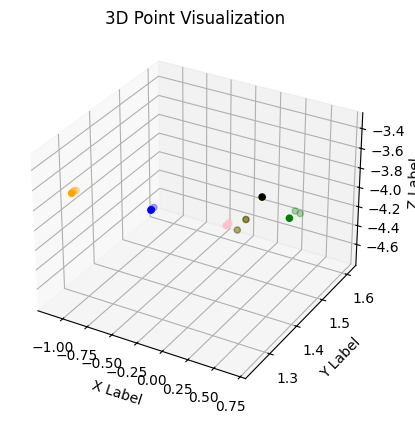

In [90]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Create a new figure for the 3D plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

colors = ['blue', 'green', 'pink', 'orange', 'yellow', 'black']

for index, tree in enumerate( points ):

    # Separate the points into x, y, and z coordinates
    x_coords = [point[0] for point in tree]
    y_coords = [point[1] for point in tree]
    z_coords = [point[2] for point in tree]



    # Scatter plot of the points
    ax.scatter(x_coords, y_coords, z_coords, c=colors[index], marker='o')

# Set labels for the axes
ax.set_xlabel('X Label')
ax.set_ylabel('Y Label')
ax.set_zlabel('Z Label')

# Set title for the plot
ax.set_title('3D Point Visualization')

# Show the plot
plt.show()


In [81]:
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from ipywidgets import interact

# Example data
# points = [(1, 2, 3), (4, 5, 6), (7, 8, 9)]  # Replace with your data

# Function to plot the 3D points
def plot_3d(elev, azim):
    # Separate the points into x, y, and z coordinates
    x_coords = [point[0] for point in points]
    y_coords = [point[1] for point in points]
    z_coords = [point[2] for point in points]

    # Create a new figure for the 3D plot
    fig = plt.figure()
    ax = fig.add_subplot(111, projection='3d')

    # Scatter plot of the points
    ax.scatter(x_coords, y_coords, z_coords, c='b', marker='o')

    # Set labels for the axes
    ax.set_xlabel('X Label')
    ax.set_ylabel('Y Label')
    ax.set_zlabel('Z Label')

    # Set title for the plot
    ax.set_title('3D Point Visualization')

    # Set elevation and azimuth
    ax.view_init(elev=elev, azim=azim)

    # Show the plot
    plt.show()

# Create an interactive plot using ipywidgets
interact(plot_3d, elev=(-90, 90), azim=(-180, 180))


interactive(children=(IntSlider(value=0, description='elev', max=90, min=-90), IntSlider(value=0, description=…

<function __main__.plot_3d(elev, azim)>